In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import TruncatedSVD
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import KMeans
from fuzzywuzzy import fuzz
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
from matplotlib import pyplot as plt
import networkx as nx
import networkx.drawing.layout as nxlayout
import re

In [2]:
df = pd.read_csv('../input/Black Panther.csv', encoding = "ISO-8859-1")
print(df.shape)
df.head()

(72850, 5)


,Tweets,User_name,Language,Location,Time
0,RT @CoachWilmore: #120: William OÕNeal and the...,SusieNattibree,en,NaN,Sun Mar 04 10:28:35 +0000 2018
1,RT @soprettyinlou: I hope my girl Shuri can br...,zinedine_7x,en,P,Sun Mar 04 10:28:35 +0000 2018
2,"RT @PollsNig: Ok guys get in here, who do you ...",edxxtrock,en,"Toulouse, France",Sun Mar 04 10:28:35 +0000 2018
3,the thing is... black panther was so so good b...,zekejaegers,en,NaN,Sun Mar 04 10:28:36 +0000 2018
4,RT @HillaryClinton: Saw Black Panther with Bil...,quirion77,en,"Loire-Atlantique, Pays de la Loire",Sun Mar 04 10:28:36 +0000 2018


In [3]:
from html.parser import HTMLParser
df.Tweets = df.Tweets.apply(HTMLParser().unescape)
df.head()

,Tweets,User_name,Language,Location,Time
0,RT @CoachWilmore: #120: William OÕNeal and the...,SusieNattibree,en,NaN,Sun Mar 04 10:28:35 +0000 2018
1,RT @soprettyinlou: I hope my girl Shuri can br...,zinedine_7x,en,P,Sun Mar 04 10:28:35 +0000 2018
2,"RT @PollsNig: Ok guys get in here, who do you ...",edxxtrock,en,"Toulouse, France",Sun Mar 04 10:28:35 +0000 2018
3,the thing is... black panther was so so good b...,zekejaegers,en,NaN,Sun Mar 04 10:28:36 +0000 2018
4,RT @HillaryClinton: Saw Black Panther with Bil...,quirion77,en,"Loire-Atlantique, Pays de la Loire",Sun Mar 04 10:28:36 +0000 2018


In [4]:
hashtags = []
for i in range(df.shape[0]):
    hashtags+= [i for i in df.iloc[i,0].split() if i.find('#')== 0]
hashtags[:5]

['#120:', '#BlackPanther', '#Marvel', '#Disney', '#MovieReview']

In [5]:
hashtags_unique, hashtags_count = np.unique(hashtags,return_counts=True)
hashtags_dict = dict(zip(hashtags_unique, hashtags_count))

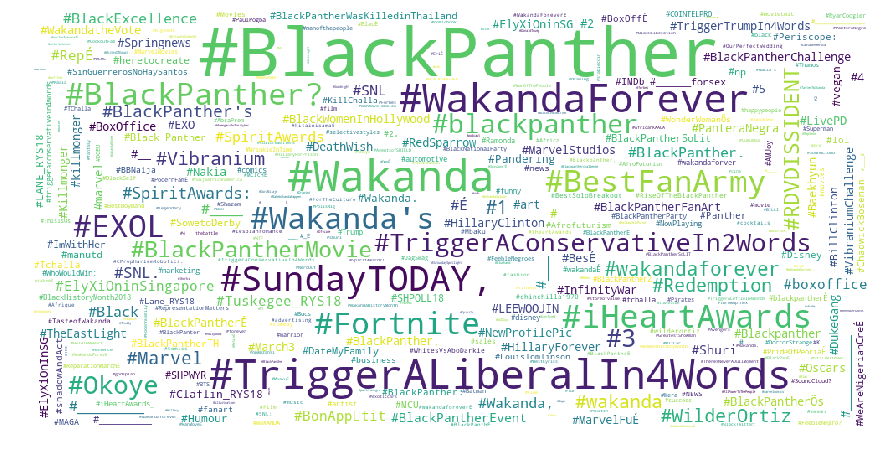

In [6]:
from wordcloud import WordCloud
wordcloud = WordCloud(regexp=r".*",background_color='white',max_words=500,max_font_size=80,random_state=42,width = 1000, height = 500,collocations=False).generate_from_frequencies(hashtags_dict)
plt.figure(figsize=(15,8))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

In [7]:
from nltk.corpus import stopwords
import nltk
import itertools
stopword = list(set(stopwords.words('english')))

def clearstring(string):
    string = ' '.join([i for i in string.split() if i.find('RT') < 0 and i.find('@') < 0 and i.find('#') < 0])
    # remove link
    string = re.sub(r'(https|http)?:\/\/(\w|\.|\/|\?|\=|\&|\%)*\b', '', string, flags=re.MULTILINE)
    # tokenize using nltk
    string = ' '.join(nltk.word_tokenize(string))
    # only accept A-Z a-z -
    string = re.sub('[^A-Za-z\- ]+', '', string).split()
    string = filter(None, string)
    string = [y.strip() for y in string]
    # remove stopwords
    string = ' '.join([y.lower() for y in string if len(y) > 3 and y.find('nbsp') < 0 and y not in stopword])
    # remove repeating characters
    return ''.join(''.join(s)[:2] for _, s in itertools.groupby(string))

Let we check languages used for related tweets

In [8]:
language_unique, language_count = np.unique(df['Language'], return_counts = True)
data = [go.Bar(
            x=language_unique,
            y=language_count,
    text=language_count,
    textposition = 'auto',
            marker=dict(
                color='rgb(179, 224, 255)',
                line=dict(
                    color='rgb(8,48,107)',
                    width=0.5),
            ),
            opacity=0.9
)]
layout = go.Layout(
    title = 'language count',
     margin = dict(
        t = 50
    )
)
fig = go.Figure(data = data, layout = layout)
py.iplot(fig)

Most of people tweeted in english content. French is following after that.

Let we check how many people retweeted someone tweet.

In [9]:
retweeted = []
for i in range(df.shape[0]):
    if df.iloc[i,0].find('RT') >= 0:
        retweeted.append('retweet')
    else:
        retweeted.append('no')

In [10]:
retweeted_unique, retweeted_count = np.unique(retweeted, return_counts = True)
data = [go.Bar(
            x=retweeted_unique,
            y=retweeted_count,
    text=retweeted_count,
    textposition = 'auto',
            marker=dict(
                color='rgb(179, 224, 255)',
                line=dict(
                    color='rgb(8,48,107)',
                    width=0.5),
            ),
            opacity=0.9
)]
layout = go.Layout(
    title = 'retweeted count',
     margin = dict(
        t = 50
    )
)
fig = go.Figure(data = data, layout = layout)
py.iplot(fig)

The ratio people tweeted and retweeted is 0.25 : 0.75 (i just pressed my calculator here)

Now lets clean our texts using nltk stopwords, remove alias, remove 'RT', remove special characters, and lowering

In [11]:
df.Tweets = df.Tweets.apply(clearstring)
df.head()

,Tweets,User_name,Language,Location,Time
0,william oneal murder fred hampton william onea...,SusieNattibree,en,NaN,Sun Mar 04 10:28:35 +0000 2018
1,hope girl shuri bring back erik round black pa...,zinedine_7x,en,P,Sun Mar 04 10:28:35 +0000 2018
2,guys think would battle okoye black panther bl...,edxxtrock,en,"Toulouse, France",Sun Mar 04 10:28:35 +0000 2018
3,thing black panther good session late woke ear...,zekejaegers,en,NaN,Sun Mar 04 10:28:36 +0000 2018
4,black panther bill afternoon loved beautiful f...,quirion77,en,"Loire-Atlantique, Pays de la Loire",Sun Mar 04 10:28:36 +0000 2018


In [12]:
bow = CountVectorizer().fit(df.Tweets)
tweet_bow = bow.transform(df.Tweets)
tweet_bow.shape

(72850, 16310)

In [13]:
nonzero_words = tweet_bow.nonzero()[1].tolist()
feature_names = bow.get_feature_names()
print(len(nonzero_words))
nonzero = [feature_names[i] for i in nonzero_words]
nonzero[:5]

584841


['black', 'fred', 'hampton', 'infiltrated', 'informat']

top 10 bow:  ['black' 'panther' 'wakanda' 'think' 'okoye' 'kill' 'name' 'twice'
 'spider' 'thot']


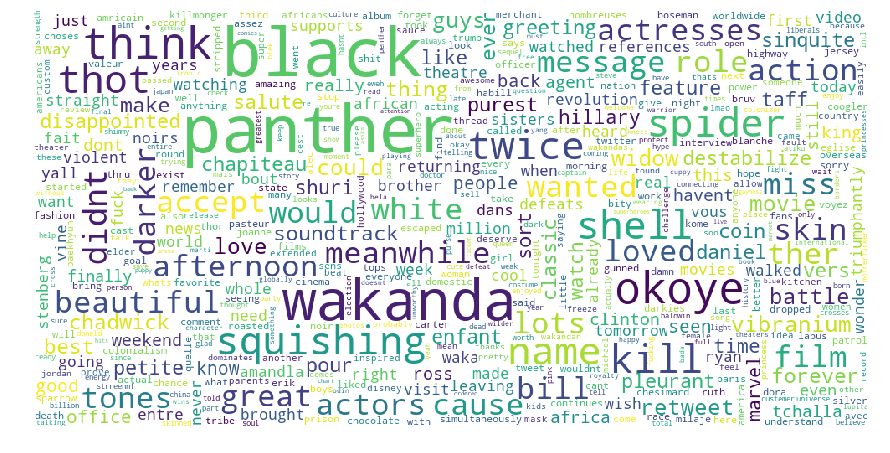

In [14]:
nonzero_unique, nonzero_count = np.unique(nonzero,return_counts=True)
print('top 10 bow: ', nonzero_unique[np.argsort(nonzero_count)[::-1]][:10])
nonzero_dict = dict(zip(nonzero_unique, nonzero_count))
wordcloud = WordCloud(regexp=r".*",background_color='white',max_words=500,max_font_size=80,random_state=42,width = 1000, height = 500,collocations=True).generate_from_frequencies(nonzero_dict)
plt.figure(figsize=(15,8))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

In [15]:
tfidf_bigram = TfidfVectorizer(ngram_range=(2, 2)).fit(df.Tweets)
tweet_tfidf_bigram = tfidf_bigram.transform(df.Tweets)
tweet_tfidf_bigram.shape

(72850, 53043)

In [16]:
nonzero_words = tweet_tfidf_bigram.nonzero()[1].tolist()
feature_names = tfidf_bigram.get_feature_names()
print(len(nonzero_words))
nonzero = [feature_names[i] for i in nonzero_words]
nonzero[:5]

535402


['william oneal',
 'oneal murder',
 'oneal informat',
 'murder fred',
 'informat infiltrated']

top 10 bigram:  ['black panther' 'spider thot' 'wakanda think' 'okoye kill' 'name wakanda'
 'think twice' 'think shell' 'twice squishing' 'squishing spider'
 'shell think']


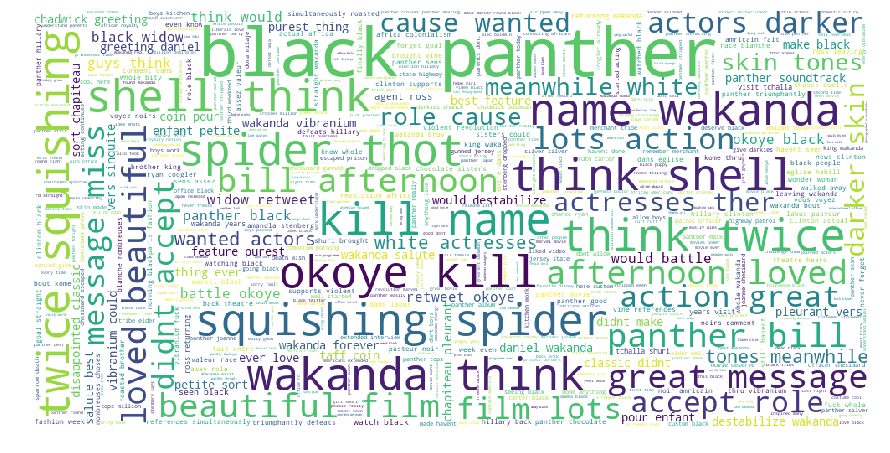

In [17]:
nonzero_unique, nonzero_count = np.unique(nonzero,return_counts=True)
print('top 10 bigram: ', nonzero_unique[np.argsort(nonzero_count)[::-1]][:10])
nonzero_dict = dict(zip(nonzero_unique, nonzero_count))
wordcloud = WordCloud(regexp=r".*",background_color='white',max_words=500,max_font_size=80,random_state=42,width = 1000, height = 500,collocations=True).generate_from_frequencies(nonzero_dict)
plt.figure(figsize=(15,8))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

In [18]:
tfidf_vectorizer = TfidfVectorizer(max_df=0.95, min_df=2)
tfidf = tfidf_vectorizer.fit_transform(df.Tweets)
tfidf_features = tfidf_vectorizer.get_feature_names()
lsa = TruncatedSVD(50).fit(tfidf)

In [19]:
lsa_blackpanther = lsa.transform(tfidf.T.dot(tfidf))
top_words = ['black','panther','wakanda','okoye','vibranium']
neighbors = NearestNeighbors(n_neighbors=10, algorithm='auto', metric='cosine').fit(lsa_blackpanther)

In [20]:
for w in top_words:
    chosen_index = np.argmax([fuzz.ratio(w, i) for i in tfidf_features])
    xtest = lsa_blackpanther[chosen_index, :]
    xtest = xtest.reshape(1, -1)
    distances, indices = neighbors.kneighbors(xtest)
    indices = indices[0][:].tolist()
    distances = distances[0][:].tolist()
    for no, n in enumerate(indices):
        print('%s and %s, similarity %f'%(w,tfidf_features[n], np.abs(1 - distances[no]/float(np.pi/2))))
    print()

black and black, similarity 1.000000
black and panther, similarity 0.993040
black and mulai, similarity 0.986855
black and olmu, similarity 0.967875
black and gzel, similarity 0.967802
black and hala, similarity 0.965601
black and you, similarity 0.961147
black and rallies, similarity 0.961147
black and incapable, similarity 0.960480
black and verbally, similarity 0.960480

panther and panther, similarity 1.000000
panther and black, similarity 0.993040
panther and gzel, similarity 0.983662
panther and olmu, similarity 0.983633
panther and incapable, similarity 0.981520
panther and expressing, similarity 0.981520
panther and verbally, similarity 0.981520
panther and hala, similarity 0.981100
panther and mulai, similarity 0.981062
panther and facial, similarity 0.979805

wakanda and wakanda, similarity 1.000000
wakanda and kill, similarity 0.939743
wakanda and name, similarity 0.939721
wakanda and twice, similarity 0.939680
wakanda and shell, similarity 0.939656
wakanda and squishing, si

I saw some bahasa words for vibranium, LOL.

In [21]:
tfidf_vectorizer = TfidfVectorizer(max_df=0.95, min_df=2)
tfidf = tfidf_vectorizer.fit_transform(df.Tweets.iloc[:500])
tfidf_features = tfidf_vectorizer.get_feature_names()
lsa = TruncatedSVD(50).fit(tfidf)
lsa_blackpanther = lsa.transform(tfidf.T.dot(tfidf))
neighbors = NearestNeighbors(n_neighbors=5, algorithm='auto', metric='cosine').fit(lsa_blackpanther)
labeldict = dict(zip(np.arange(len(tfidf_features)), tfidf_features))

G = nx.Graph()
for i in range(lsa_blackpanther.shape[0]):
    text = tfidf_features[i]
    G.add_node(i,text=text)
    
for i in range(lsa_blackpanther.shape[0]):
    chosen_index = np.argmax([fuzz.ratio(w, i) for i in tfidf_features])
    xtest = lsa_blackpanther[chosen_index, :]
    xtest = xtest.reshape(1, -1)
    distances, indices = neighbors.kneighbors(xtest)
    indices = indices[0][:].tolist()
    distances = distances[0][:].tolist()
    for j in range(1,5):
        weight=np.abs(1 - distances[j]/float(np.pi/2))
        G.add_edge(i,indices[j],weight=weight)

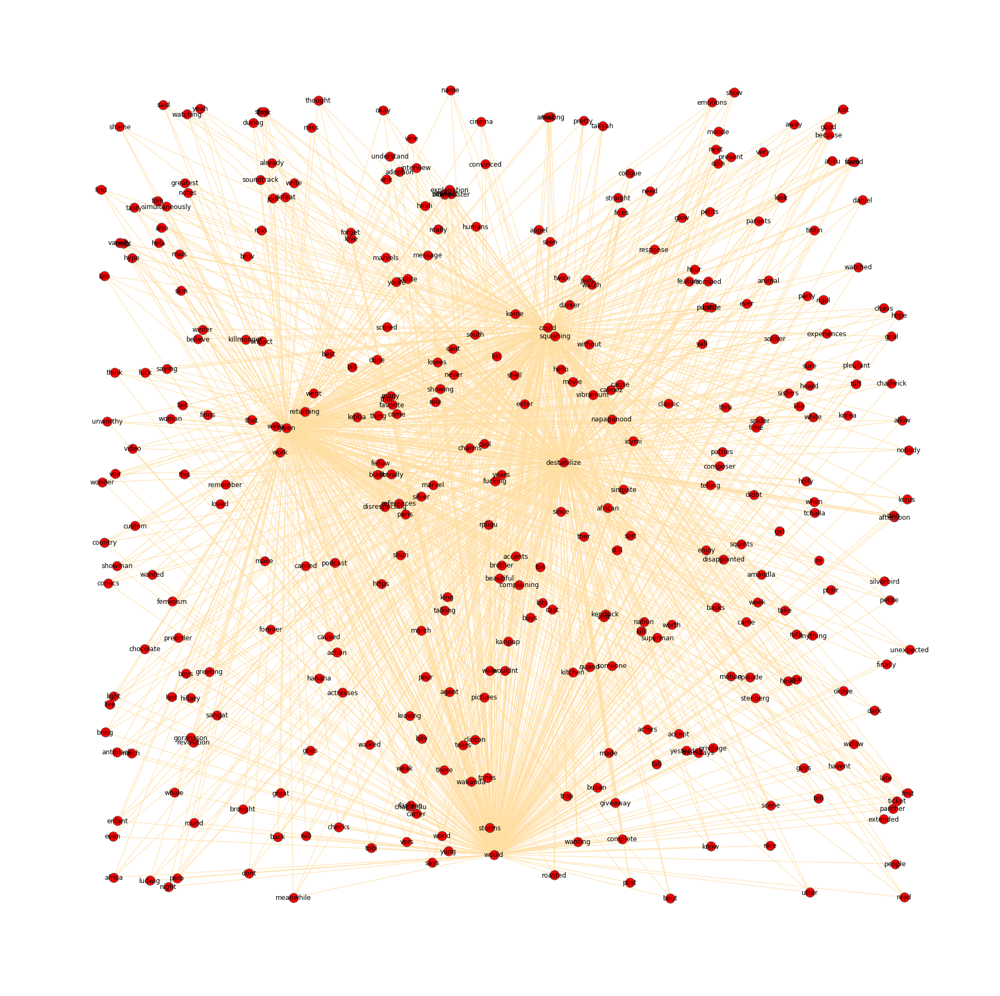

In [22]:
plt.figure(figsize=(25,25))
options = {
    'edge_color': '#FFDEA2',
    'width': 1,
    'with_labels': True,
    'font_weight': 'regular',
}
pos = nx.random_layout(G)
nx.draw(G, labels=labeldict, pos=pos, **options)
ax = plt.gca()
ax.collections[0].set_edgecolor("#555555") 
plt.show()

In [23]:
tfidf = TfidfVectorizer(stop_words='english',norm='l2')
DxT = tfidf.fit_transform(df.Tweets.iloc[:200])
DxD = np.dot(DxT,DxT.T)
kmeans = KMeans(n_clusters=5, random_state=0).fit(DxT)
labels = kmeans.labels_

In [24]:
G = nx.Graph()
for i in range(DxT.shape[0]):
    idx = i
    text = df.at[i,'Tweets']
    label = labels[i]
    G.add_node(idx,text=text,label=label)

dense_DxD = DxD.toarray()
len_dense = len(dense_DxD)
cutoff=0
for i in range(len_dense):
    for j in range(i+1,len_dense):
        if dense_DxD[i,j]>=cutoff:
            weight=dense_DxD[i,j]
            G.add_edge(i,j,weight=weight)

for node,degree in list(dict(G.degree()).items()):
    if degree == 0:
        G.remove_node(node)

pos = nxlayout.fruchterman_reingold_layout(G,k=1.5/np.sqrt(len(G.nodes())))

edge_data = []
colors = {0:'1',1:'2',2:'3',3:'4',4:'5'}
for u,v,w in G.edges(data=True):
    x0,y0 = pos[u]
    x1,y1 = pos[v]
    w = w['weight']
    edge_data.append(go.Scatter(x=[x0,x1,None],
                            y=[y0,y1,None],
                            line=go.Line(width=3.0*w,color='#888'),
                            hoverinfo='none',
                            mode='lines'))

node_data = go.Scatter(
        x=[],
        y=[],
        text=[],
        mode='markers',
        hoverinfo='text',
        marker=go.Marker(
            showscale=True,
            colorscale='Viridis',
            reversescale=True,
            color=[],
            size=5.0,
            colorbar=dict(
                thickness=15,
                xanchor='left',
                tickmode='array',
                tickvals=[1,2,3,4,5],
                ticktext=['cluster 1','cluster 2','cluster 3','cluster 4','cluster 5'],
                ticks = 'outside'
            ),
            line=dict(width=0.5)))

for u,w in G.nodes(data=True):
    x,y = pos[u]
    color = colors[w['label']]
    text = w['text']
    node_data['x'].append(x)
    node_data['y'].append(y)
    node_data['text'].append(text)
    node_data['marker']['color'].append(color)

In [25]:
py.iplot(go.Figure(data=edge_data+[node_data],
                layout=go.Layout(
                width=800,
                height=600,
                title='<br>K-means Similarity Network',
                titlefont=dict(size=16),
                showlegend=False,
                hovermode='closest',
                margin=dict(b=20,l=5,r=5,t=40),
                annotations=[ dict(
                    text="Tweets",
                    showarrow=False,
                    xref="paper", yref="paper",
                    x=0.005, y=-0.002 )],
                xaxis=go.XAxis(showgrid=False, zeroline=False, showticklabels=False),
                yaxis=go.YAxis(showgrid=False, zeroline=False, showticklabels=False))))